In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns 
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import plotly.express as px 
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity
from nltk.tokenize import RegexpTokenizer
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.sparse import hstack
from tabulate import tabulate
from sklearn.preprocessing import LabelEncoder
from sklearn.manifold import TSNE
from wordcloud import WordCloud

In [2]:
# Read data from CSV file
data = pd.read_csv(r"C:\Users\welcome\Desktop\Data Sets\Music.csv", low_memory=True)

# Make a copy of the original data
data_copy = data.copy()

In [3]:
# Check the first few rows of the data
data.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [4]:
# Get information about the data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114000 entries, 0 to 113999
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        114000 non-null  int64  
 1   track_id          114000 non-null  object 
 2   artists           113999 non-null  object 
 3   album_name        113999 non-null  object 
 4   track_name        113999 non-null  object 
 5   popularity        114000 non-null  int64  
 6   duration_ms       114000 non-null  int64  
 7   explicit          114000 non-null  bool   
 8   danceability      114000 non-null  float64
 9   energy            114000 non-null  float64
 10  key               114000 non-null  int64  
 11  loudness          114000 non-null  float64
 12  mode              114000 non-null  int64  
 13  speechiness       114000 non-null  float64
 14  acousticness      114000 non-null  float64
 15  instrumentalness  114000 non-null  float64
 16  liveness          11

In [5]:
# Convert 'duration_ms' to minutes and round up
data['duration_ms'] = (data['duration_ms'] / 60000).apply(np.ceil)

# Rename column 'duration_ms' to 'duration_s'
data.rename(columns={'duration_ms': 'duration_m'}, inplace=True)

# Check the first few rows of the modified data
data.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_m,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,4.0,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,3.0,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,4.0,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,4.0,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,4.0,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [6]:
# Check the shape of the data after modifications
data.shape

(114000, 21)

In [7]:
# Remove duplicate rows
data = data.drop_duplicates()

In [8]:
# Display the count of unique values for each column
table = []
for col in data.columns:
    row = [col, data[col].nunique()]
    table.append(row)
print(tabulate(table, headers=['Column', 'Unique Values']))

Column              Unique Values
----------------  ---------------
Unnamed: 0                 114000
track_id                    89741
artists                     31437
album_name                  46589
track_name                  73608
popularity                    101
duration_m                     54
explicit                        2
danceability                 1174
energy                       2083
key                            12
loudness                    19480
mode                            2
speechiness                  1489
acousticness                 5061
instrumentalness             5346
liveness                     1722
valence                      1790
tempo                       45653
time_signature                  5
track_genre                   114


In [9]:
# Drop unnecessary columns
data = data.drop(["Unnamed: 0", "track_id"], axis=1)

In [10]:
# Round up 'tempo' column
data["tempo"] = data["tempo"].apply(np.ceil)

In [11]:
# Get categorical and numerical columns
Cat_Columns = data.select_dtypes(include="object").columns
Num_Columns = data.select_dtypes(include="number").columns

# Get descriptive statistics for numerical columns
data.describe()

,popularity,duration_m,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000
mean,33.238535,4.300719,0.566800,0.641383,5.309140,-8.258960,0.637553,0.084652,0.314910,0.156050,0.213553,0.474068,122.650044,3.904035
std,22.305078,1.810893,0.173542,0.251529,3.559987,5.029337,0.480709,0.105732,0.332523,0.309555,0.190378,0.259261,29.978968,0.432621
min,0.000000,0.000000,0.000000,0.000000,0.000000,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,3.000000,0.456000,0.472000,2.000000,-10.013000,0.000000,0.035900,0.016900,0.000000,0.098000,0.260000,100.000000,4.000000
50%,35.000000,4.000000,0.580000,0.685000,5.000000,-7.004000,1.000000,0.048900,0.169000,0.000042,0.132000,0.464000,123.000000,4.000000
75%,50.000000,5.000000,0.695000,0.854000,8.000000,-5.003000,1.000000,0.084500,0.598000,0.049000,0.273000,0.683000,141.000000,4.000000
max,100.000000,88.000000,0.985000,1.000000,11.000000,4.532000,1.000000,0.965000,0.996000,1.000000,1.000000,0.995000,244.000000,5.000000


In [12]:
# Check for missing values
data.isna().sum()

artists             1
album_name          1
track_name          1
popularity          0
duration_m          0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [13]:
# Drop rows with missing values
data = data.dropna()
data_copy = data_copy.dropna()

In [14]:
# Display skewness and kurtosis for numerical columns
table = []
for col in Num_Columns:
    row = [col, data[col].skew(), data[col].kurt()]
    table.append(row)
print(tabulate(table, headers=['Column', 'Skewness', 'Kurtosis']))

Column               Skewness    Kurtosis
----------------  -----------  ----------
popularity         0.0463935    -0.927738
duration_m        10.8109      338.733
danceability      -0.399505     -0.184515
energy            -0.597005     -0.525725
key               -0.00848879   -1.27658
loudness          -2.00654       5.89623
mode              -0.572326     -1.67247
speechiness        4.64749      28.8241
acousticness       0.727321     -0.949889
instrumentalness   1.73439       1.2707
liveness           2.10573       4.37822
valence            0.115097     -1.02742
tempo              0.231182     -0.10253
time_signature    -4.0983       26.013


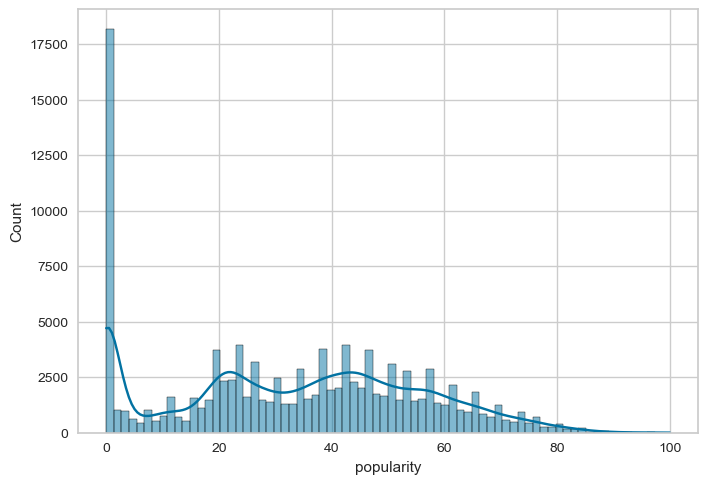

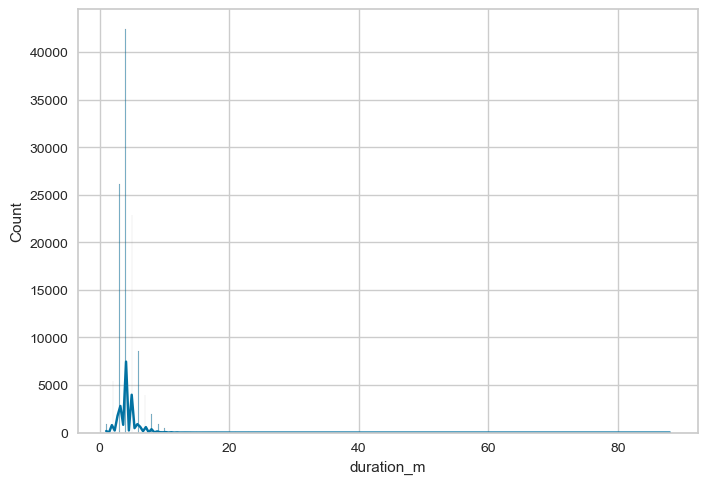

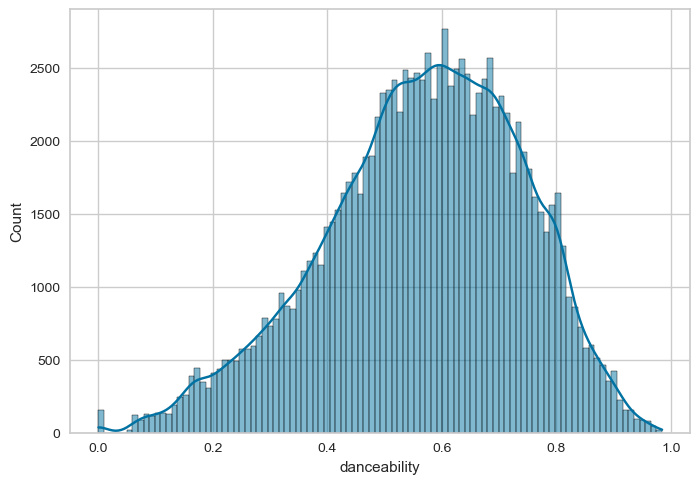

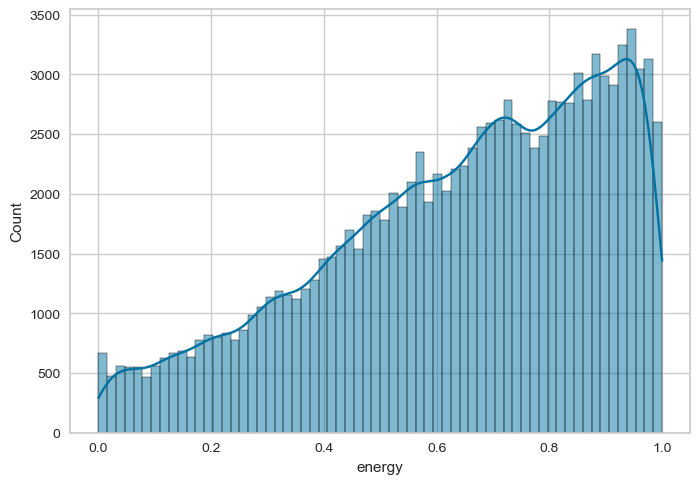

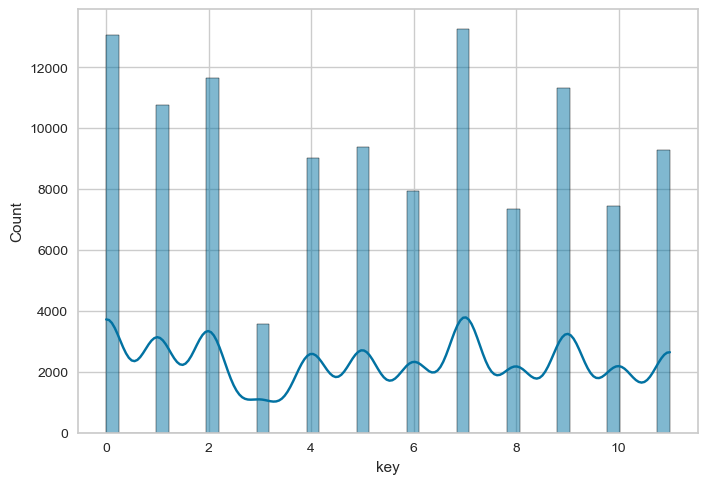

...

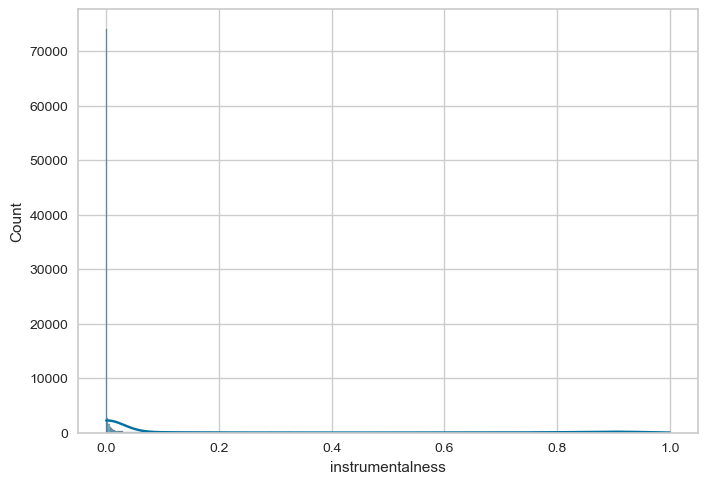

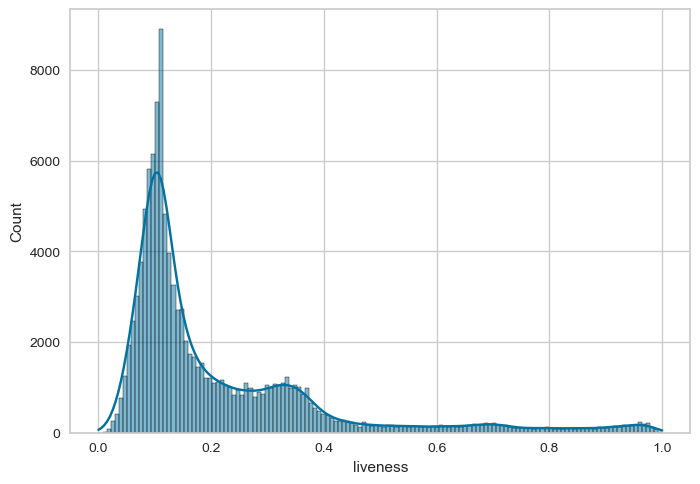

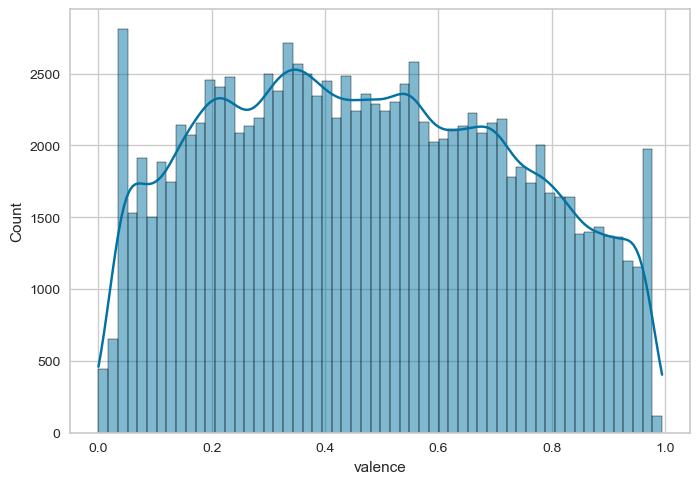

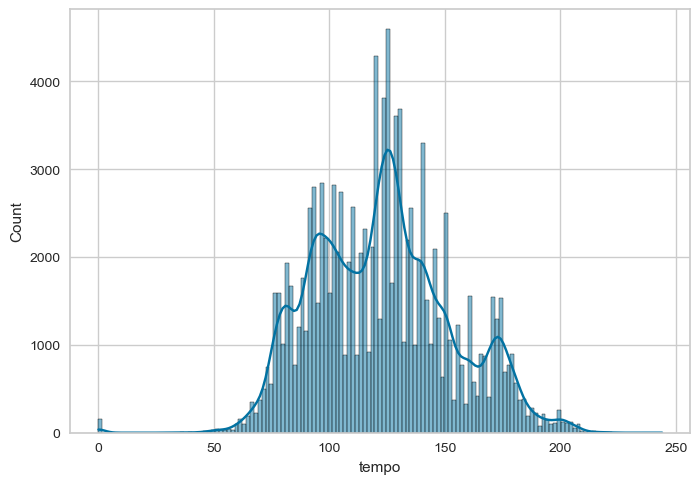

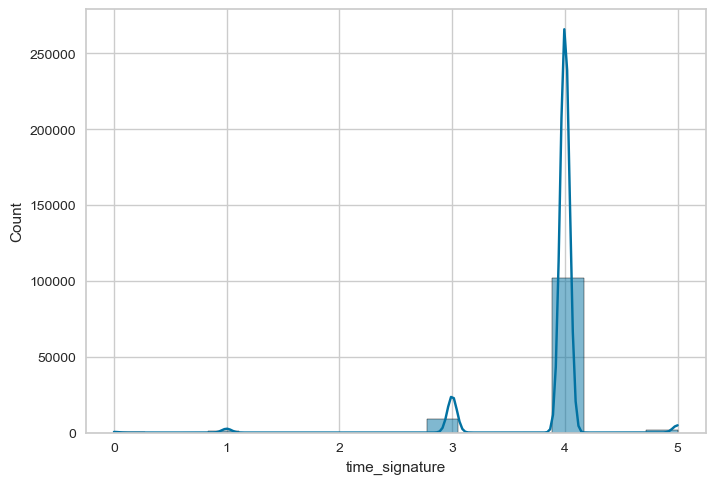

In [15]:
# Plot histograms for numerical columns
for col in Num_Columns:
    sns.histplot(x=col, data=data, kde=True)
    plt.show()

<AxesSubplot:>

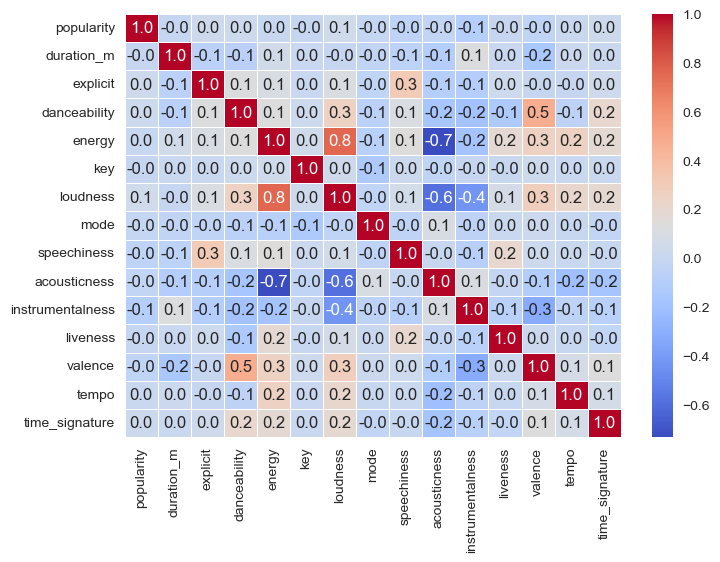

In [16]:
# Compute and visualize correlation matrix
data.corr()
sns.heatmap(data.corr(), annot=True, cmap='coolwarm', fmt=".1f", linewidths=.5)

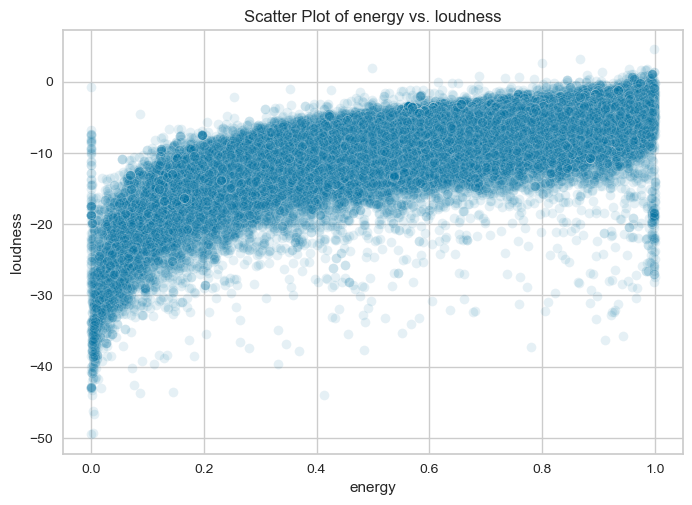

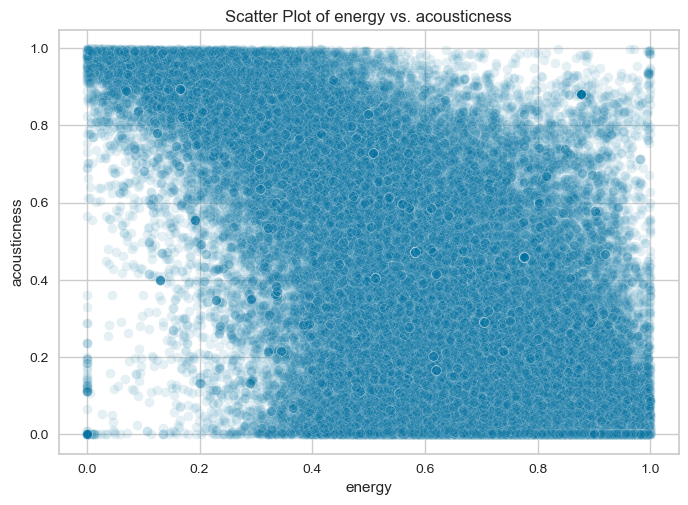

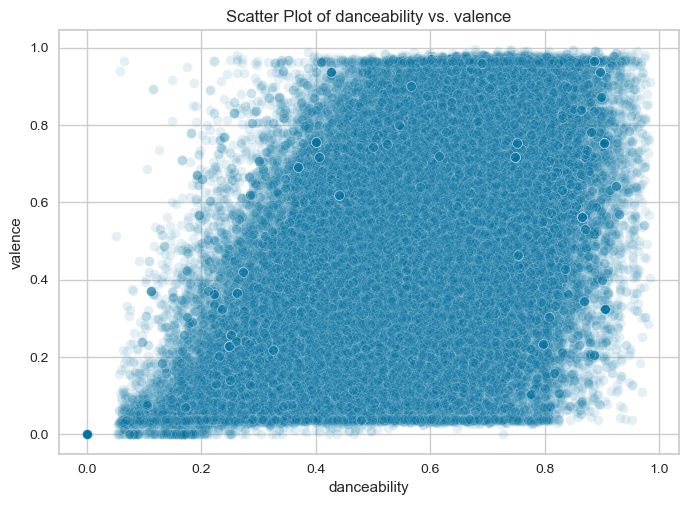

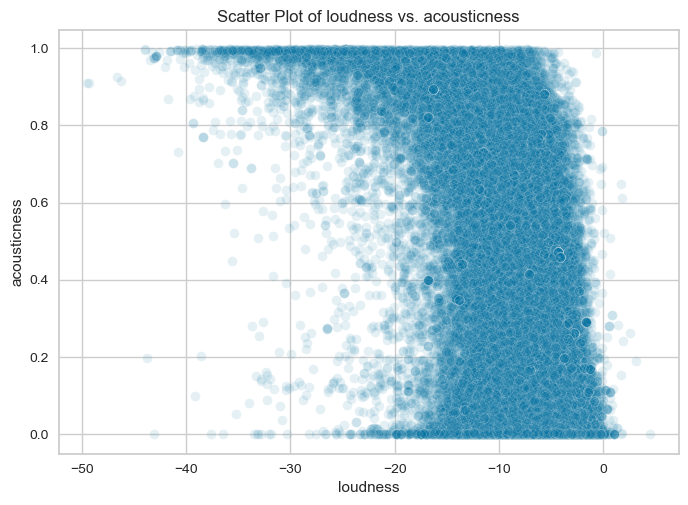

In [17]:
# Visualize scatter plots for selected pairs of numerical columns
cols_to_plot = [('energy', 'loudness'), ('energy', 'acousticness'), ('danceability', 'valence'), ('loudness', 'acousticness')]
for col1, col2 in cols_to_plot:
    sns.scatterplot(data=data, x=col1, y=col2, alpha=0.1)
    plt.title(f'Scatter Plot of {col1} vs. {col2}')
    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.show()

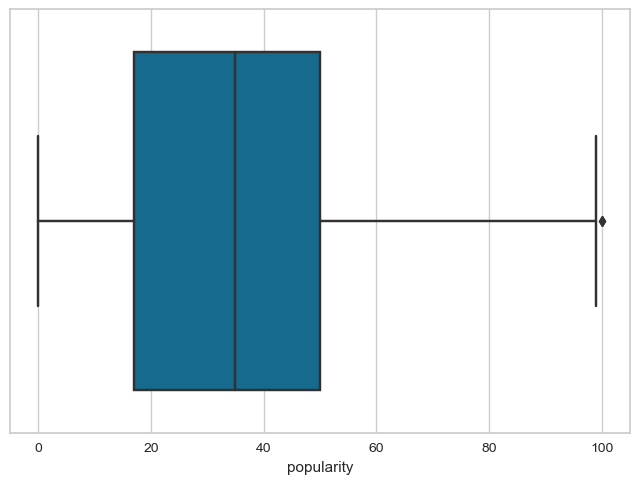

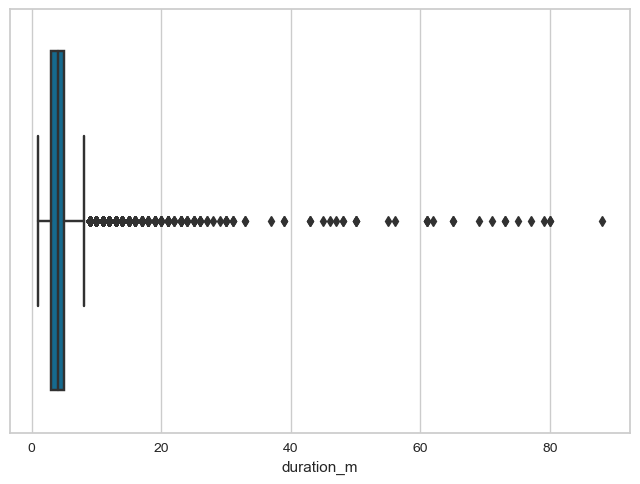

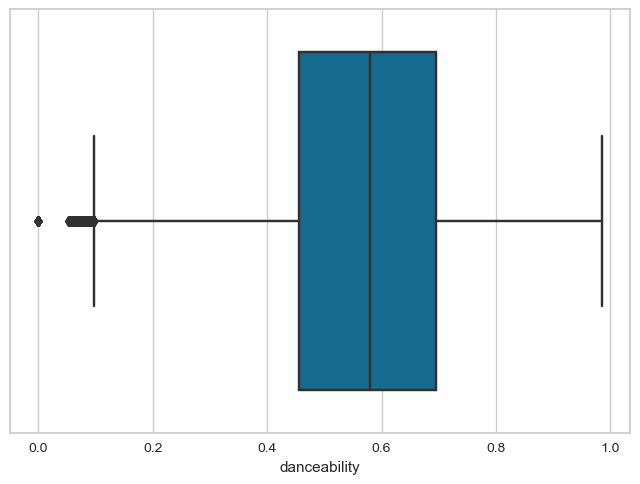

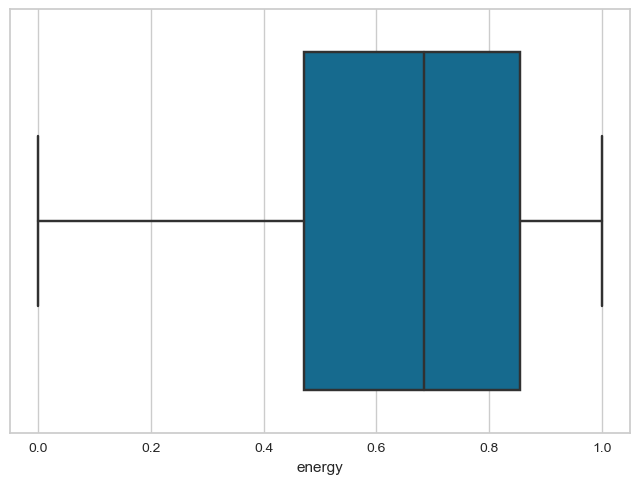

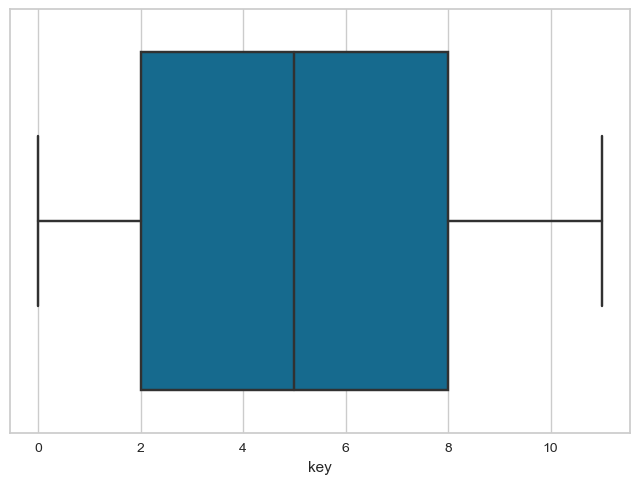

...

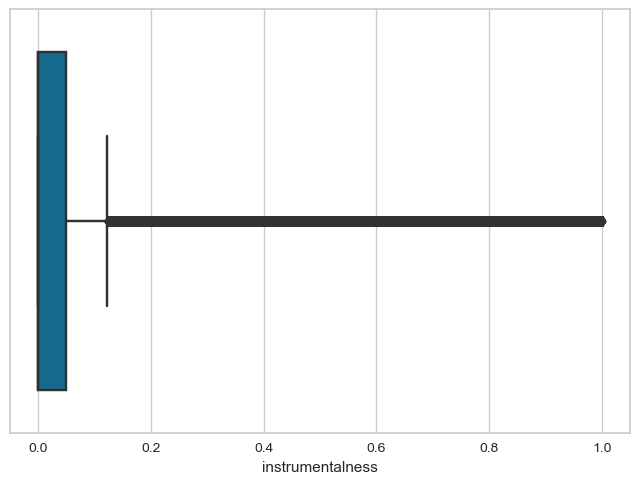

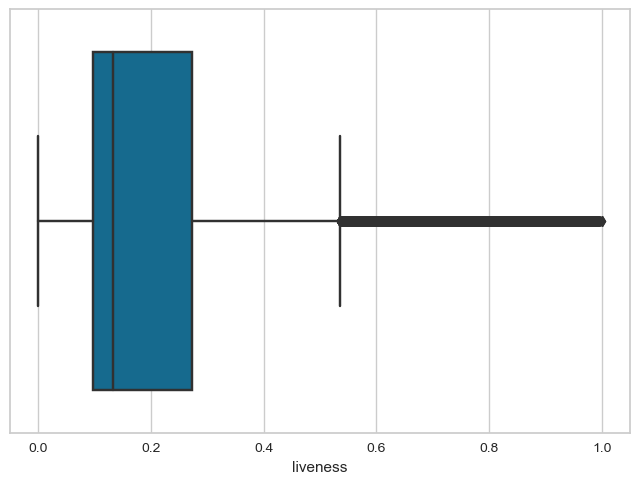

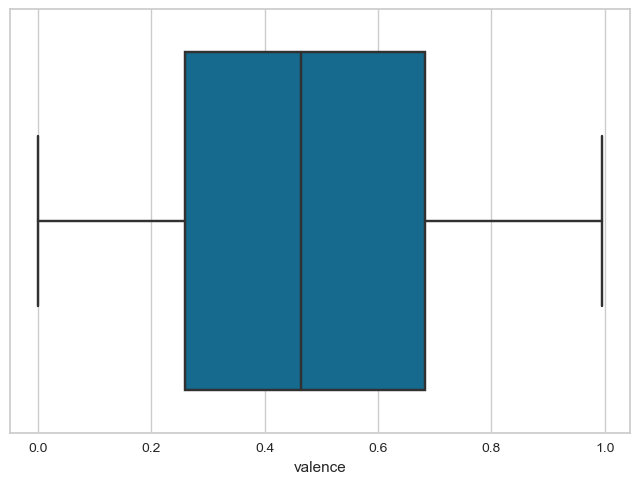

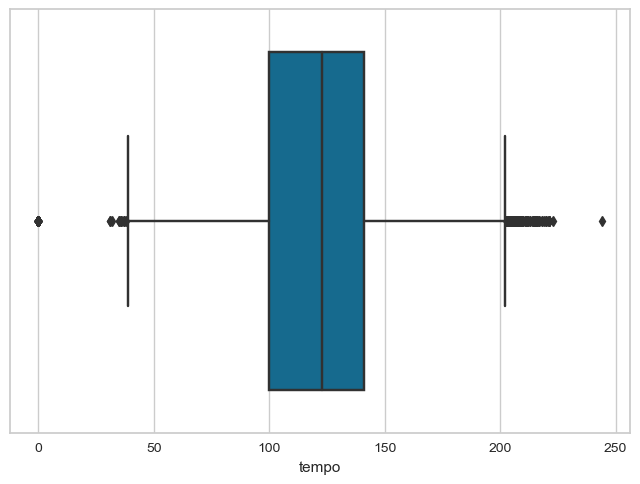

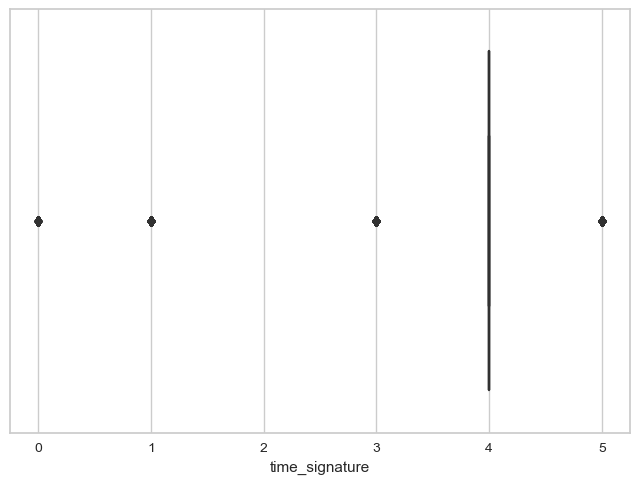

In [18]:
# Visualize boxplots for numerical columns
for col in Num_Columns:
    sns.boxplot(x=col, data=data)
    plt.show()

In [19]:
# Display percentage of outliers for each numerical column
table = []
for col in Num_Columns:
    IQR = data[col].quantile(0.75) - data[col].quantile(0.25)
    lower = data[col].quantile(0.25) - 1.5 * IQR
    upper = data[col].quantile(0.75) + 1.5 * IQR
    outlier = (data[col] <= lower) | (data[col] >= upper)
    outlier_percentage = (data[outlier].shape[0] / data.shape[0]) * 100
    row = [col, outlier_percentage]
    table.append(row)
print(tabulate(table, headers=['Column', 'Outlier Percentage']))

Column              Outlier Percentage
----------------  --------------------
popularity                   0.0017544
duration_m                   3.38161
danceability                 0.543864
energy                       0
key                          0
loudness                     5.41584
mode                         0
speechiness                 11.5887
acousticness                 0
instrumentalness            22.1458
liveness                     7.58077
valence                      0
tempo                        0.510531
time_signature             100


In [20]:
# Replace outliers with mean values based on 'track_genre'
for col in Num_Columns:
    Col_dict = data.groupby("track_genre")[col].mean().to_dict()
    IQR = data[col].quantile(0.75) - data[col].quantile(0.25)
    lower = data[col].quantile(0.25) - 1.5 * IQR
    upper = data[col].quantile(0.75) + 1.5 * IQR
    outlier = (data[col] <= lower) | (data[col] >= upper)
    data.loc[outlier, col] = data['track_genre'].map(Col_dict)

In [21]:
# Re-calculate and display percentage of outliers after replacing
table = []
for col in Num_Columns:
    IQR = data[col].quantile(0.75) - data[col].quantile(0.25)
    lower = data[col].quantile(0.25) - 1.5 * IQR
    upper = data[col].quantile(0.75) + 1.5 * IQR
    outlier = (data[col] <= lower) | (data[col] >= upper)
    outlier_percentage = (data[outlier].shape[0] / data.shape[0]) * 100
    row = [col, outlier_percentage]
    table.append(row)
print(tabulate(table, headers=['Column', 'Outlier Percentage']))

Column              Outlier Percentage
----------------  --------------------
popularity                     0
duration_m                     0
danceability                   0
energy                         0
key                            0
loudness                       2.46493
mode                           0
speechiness                    4.42723
acousticness                   0
instrumentalness              20.044
liveness                       3.06231
valence                        0
tempo                          0
time_signature                 7.01761


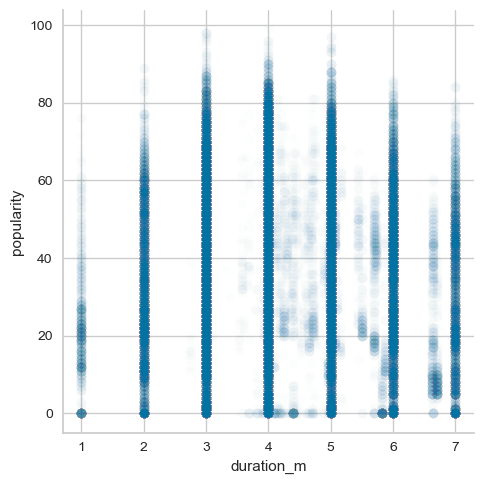

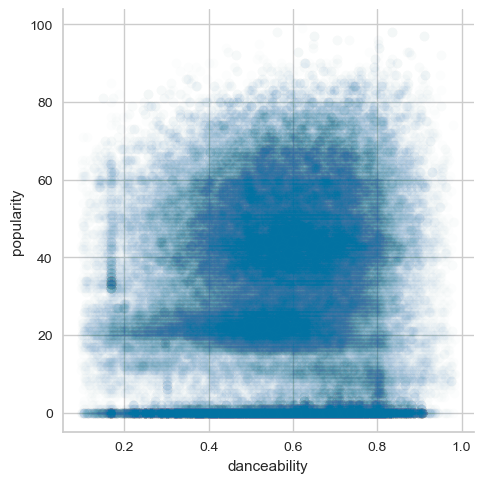

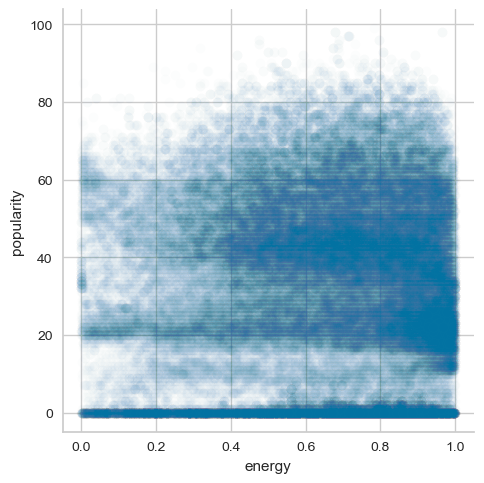

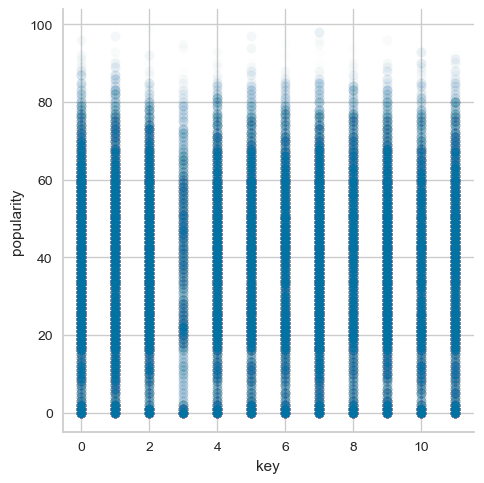

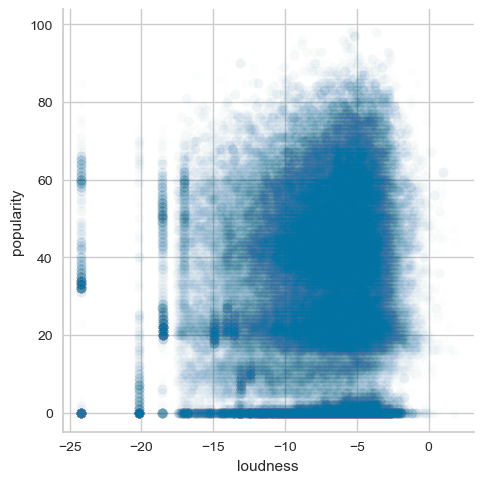

...

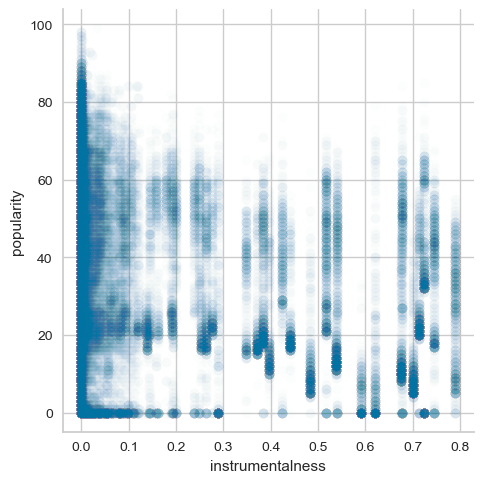

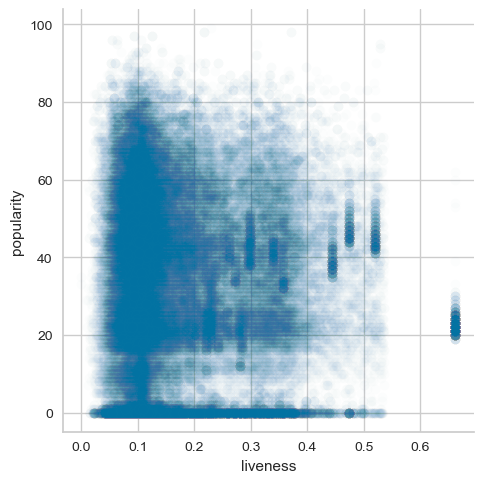

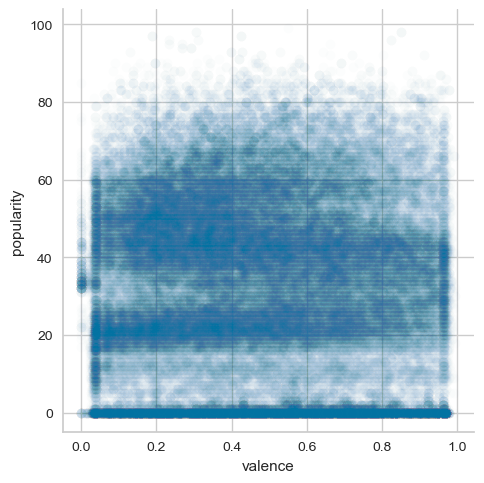

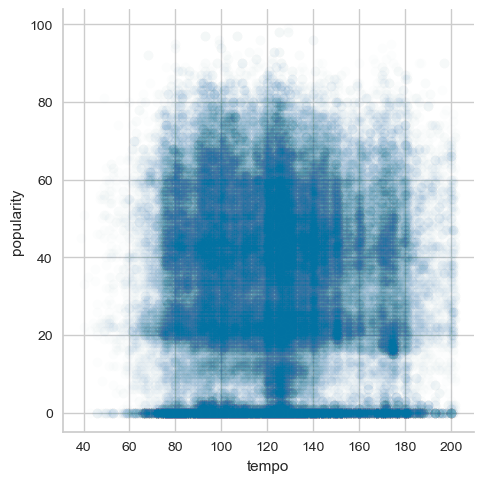

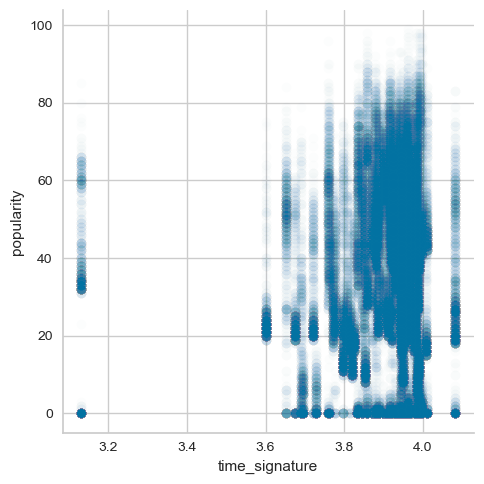

In [22]:
# Visualize the relationship of numerical variables with popularity
category = ['duration_m', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
                  'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']
for col in category:
    sns.relplot(x=col, y='popularity', data=data, kind='scatter', alpha=0.01)

In [23]:
# Encode categorical variables and one-hot encode 
data_encoded = data
label_encoder = LabelEncoder()
for col in Cat_Columns:
    data_encoded[col] = label_encoder.fit_transform(data[col])
data_encoded = pd.get_dummies(data_encoded, columns=['explicit'])

In [24]:
# Scale numerical variables using MinMaxScaler
data_scaled = data_encoded
scaler = MinMaxScaler()
Columns = data_encoded.columns
for col in Columns:
    data_scaled[col] = scaler.fit_transform(data_encoded[[col]])

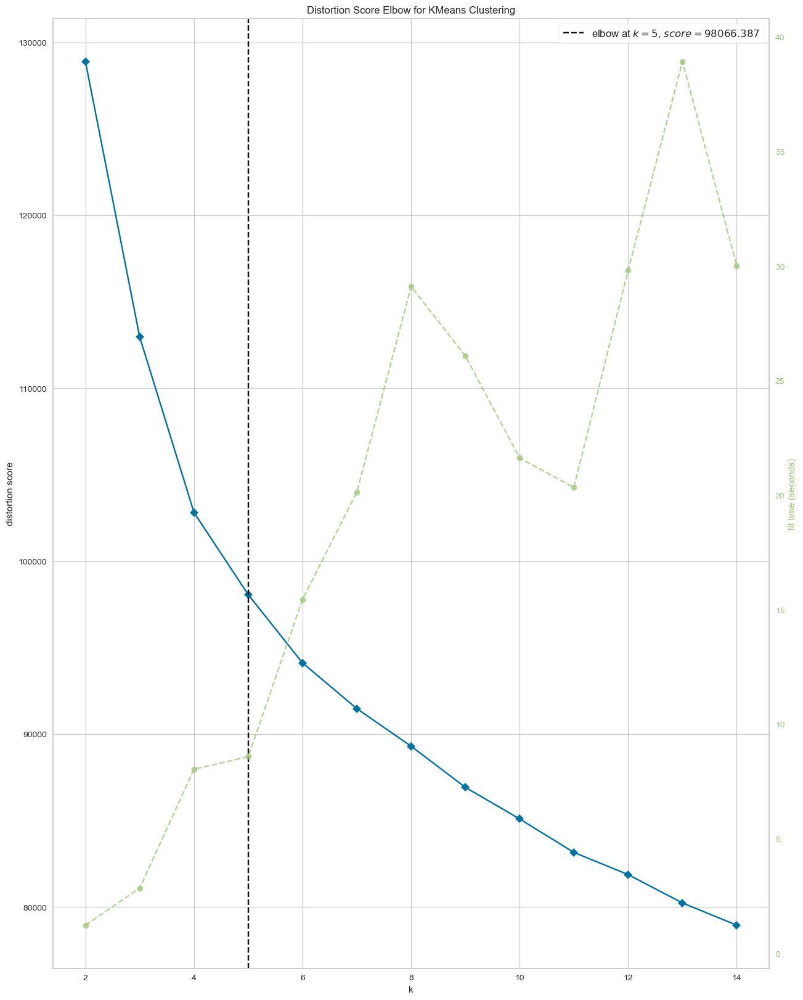

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [25]:
# Visualize the elbow method to find optimal K in KMeans
plt.figure(figsize=(15, 20))
Elbow_M = KElbowVisualizer(KMeans(), k=(2, 15))
Elbow_M.fit(data_scaled)
Elbow_M.show()

In [26]:
# Apply KMeans clustering with obtained K
model = KMeans(n_clusters=5)
model.fit(data_scaled)
data_copy["Cluster"] = model.labels_

In [27]:
# Reduce dimensionality using PCA
pca = PCA(n_components=2)
embedding = pca.fit_transform(data_scaled)
projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
projection['title'] = data_copy['track_name']
projection['genre'] = data_copy['track_genre']
projection['cluster'] = model.labels_

In [28]:
# Visualize clusters using scatter plot
fig = px.scatter(projection, x='x', y='y', color=model.labels_, hover_data=['title', 'genre', 'cluster'])
fig.show()

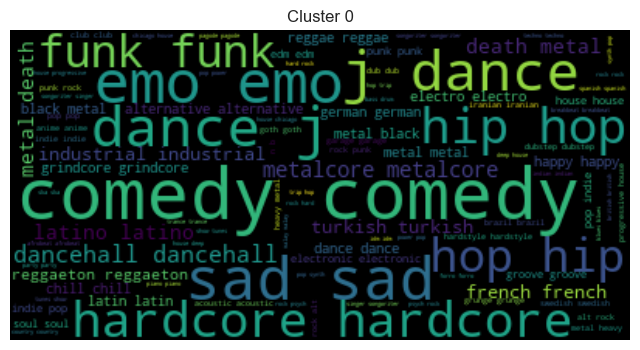

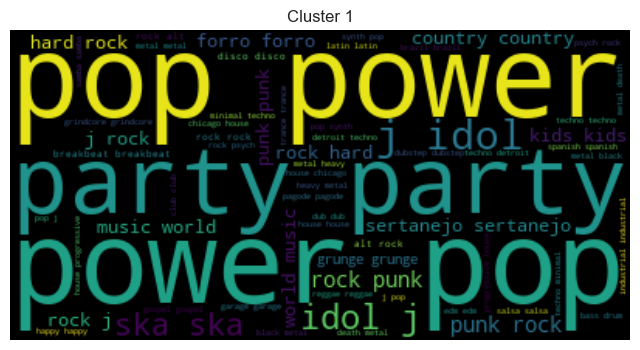

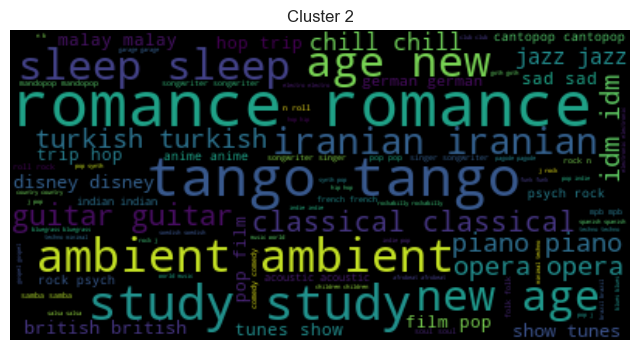

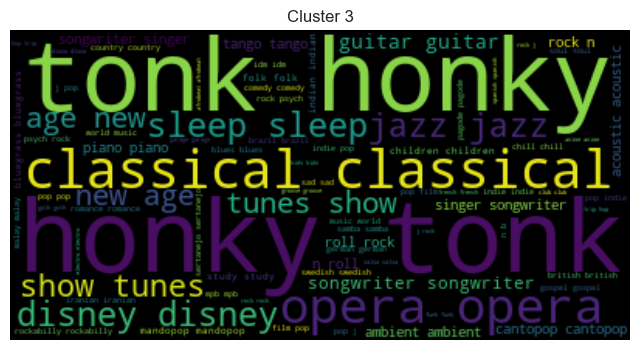

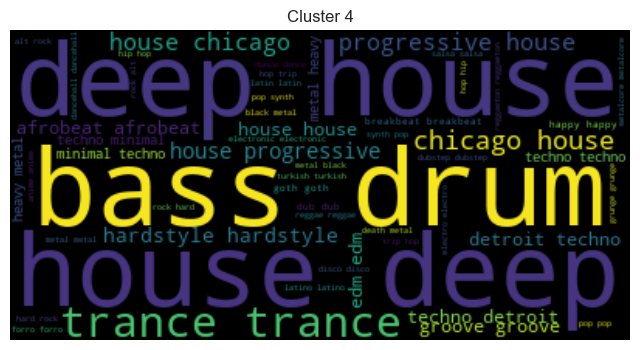

In [29]:
# Generate word clouds for each cluster
for i in range(0, 5):
    text = list(data_copy[data_copy['Cluster'] == i]['track_genre'])
    text = str(text).replace(",", ' ')
    text = str(text).replace("[", ' ')
    text = str(text).replace("]", '')
    text = str(text).replace("'", '')
    wordcloud = WordCloud().generate(text)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title('Cluster ' + str(i))
    plt.show()

In [30]:
# Define a function for preprocessing
def preprocess(data):
    s = list(data.select_dtypes(include='object').columns)
    s.remove("track_name")
    s.remove("track_id")
    data['all_text'] = data[s].apply(lambda x: ','.join(x.dropna().astype(str)), axis=1)
    token = RegexpTokenizer(r'[a-zA-Z]+')
    cv = TfidfVectorizer(lowercase=True, stop_words='english', ngram_range=(1, 1), tokenizer=token.tokenize)
    text_counts = cv.fit_transform(data['all_text'])
    ndf = data.select_dtypes(include=['float64', "int64"])
    scaler = preprocessing.MinMaxScaler(feature_range=(0, 1))
    ndfmx = pd.DataFrame((scaler.fit_transform(ndf)))
    ndfmx.columns = ndf.columns
    popularity = ndfmx.popularity.values[:, None]
    X_train_dtm = hstack((text_counts, popularity))
    duration_s = ndfmx.duration_ms.values[:, None]
    X_train_dtm = hstack((X_train_dtm, duration_s))
    danceability = ndfmx.danceability.values[:, None]
    X_train_dtm = hstack((X_train_dtm, danceability))
    energy = ndfmx["energy"].values[:, None]
    X_train_dtm = hstack((X_train_dtm, energy))
    key = ndfmx["key"].values[:, None]
    X_train_dtm = hstack((X_train_dtm, key))
    loudness = ndfmx.loudness.values[:, None]
    X_train_dtm = hstack((X_train_dtm, loudness))
    speechiness = ndfmx.speechiness.values[:, None]
    X_train_dtm = hstack((X_train_dtm, speechiness))
    acousticness = ndfmx.acousticness.values[:, None]
    X_train_dtm = hstack((X_train_dtm, acousticness))
    instrumentalness = ndfmx.instrumentalness.values[:, None]
    X_train_dtm = hstack((X_train_dtm, instrumentalness))
    liveness = ndfmx.liveness.values[:, None]
    X_train_dtm = hstack((X_train_dtm, liveness))
    valence = ndfmx.valence.values[:, None]
    X_train_dtm = hstack((X_train_dtm, valence))
    tempo = ndfmx.tempo.values[:, None]
    X_train_dtm = hstack((X_train_dtm, tempo))
    time_signature = ndfmx.time_signature.values[:, None]
    X_train_dtm = hstack((X_train_dtm, time_signature))
    return X_train_dtm

In [31]:
# Preprocess data and compute cosine similarity
mat = preprocess(data_copy.head(5000))
sig = cosine_similarity(mat, mat)

# Reverse mapping of indices and movie titles
data_copy=data_copy.drop_duplicates(subset=['track_name'])
indices = pd.Series(data_copy.index, index=data_copy['track_name'])

C:\Users\welcome\AppData\Local\Temp\ipykernel_12476\23252566.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [32]:
# Define a function to recommend songs based on similarity
def give_rec(title, sig=sig):
    idx = indices[title]
    sig_scores = list(enumerate(sig[idx]))
    sig_scores = sorted(sig_scores, key=lambda x: x[1], reverse=True)
    sig_scores = sig_scores[1:11]
    song_indices = [i[0] for i in sig_scores]
    return data_copy[['track_name', 'Cluster']].iloc[song_indices]

In [33]:
# Test the recommendation function
give_rec("Can't Help Falling In Love", sig=sig)

,track_name,Cluster
723,Your Song,3
5597,Atraparlos Ya! (Pokemon),1
319,Chasing Cars,3
211,Poison & Wine,3
313,For Now,3
357,Look For The Good (Single Version),1
590,Can't Go Back Now,1
240,Colors,3
399,Stickup,0
1041,Fio de Pumo (Padê Onã),1
